In [1]:

ftol = xtol = gtol = 1e-4

std_gps = 2
n_gps = 10

include_gis = True

plot = True


In [2]:

import sys
import os
import json

from math import atan2, pi

import matplotlib.pyplot as plt

cwd = os.path.abspath(os.path.join('..'))

cwd = 'd:\\WindowsFolders\\Code\\Master\\jayde16_olvea16_masters_2021\\robsim'

if cwd not in sys.path:
    sys.path.append(cwd)

print(f'cwd: {cwd}')

import robsim as rs

print(f'robsim module version: {rs.__version__}')

import numpy as np
import random

some_id_for_plots = random.randint(0, 100000000)

seed = 0


np.random.seed(seed)
random.seed(seed)

cwd: d:\WindowsFolders\Code\Master\jayde16_olvea16_masters_2021\robsim
robsim module version: 0.0.1a


In [3]:
config_file = os.path.join(cwd, 'workspaces/office_workspace_1.json')
map_file = os.path.join(cwd, 'workspaces/office_workspace_1.png')

ws = rs.Workspace(
    config_file=config_file, 
    background_file=map_file
)


In [4]:
path = os.path.join(cwd, 'data/office_workspace_1_default_landmarks.json')
with open(path, 'r') as f:
    landmarks = json.load(f)

default_landmarks = True

ws.set_landmarks(landmarks)

In [5]:
path = os.path.join(cwd, 'data/office_workspace_1_default_route.json')
with open(path, 'r') as f:
    nodes = json.load(f)

default_route = True


In [6]:
d = 0.01 # Approximate step size for the interpolation.

angles = [atan2((y2 - y1), (x2 - x1)) for (x1, y1), (x2, y2) in zip(nodes[:-1], nodes[1:])]
angles = [angles[0]] + angles

angles = [angle % (2 * pi) for angle in angles]

for i in range(len(angles) - 1):
    angles[i + 1] = rs.minimize_angular_difference(angles[i], angles[i + 1])

poses = [rs.Pose(click[0], click[1], v) for v, click in zip(angles, nodes)]

poses = [poses[0]] + poses + [poses[-1]]

paths = [rs.rom_spline(poses[i:i+4], d=d) for i in range(len(poses) - 3)]

full_route = [pose for path in paths for pose in path]

# This breaks noise application
#route = [rs.Pose(pose.x, pose.y, pose.theta % (2 * pi)) for pose in route]


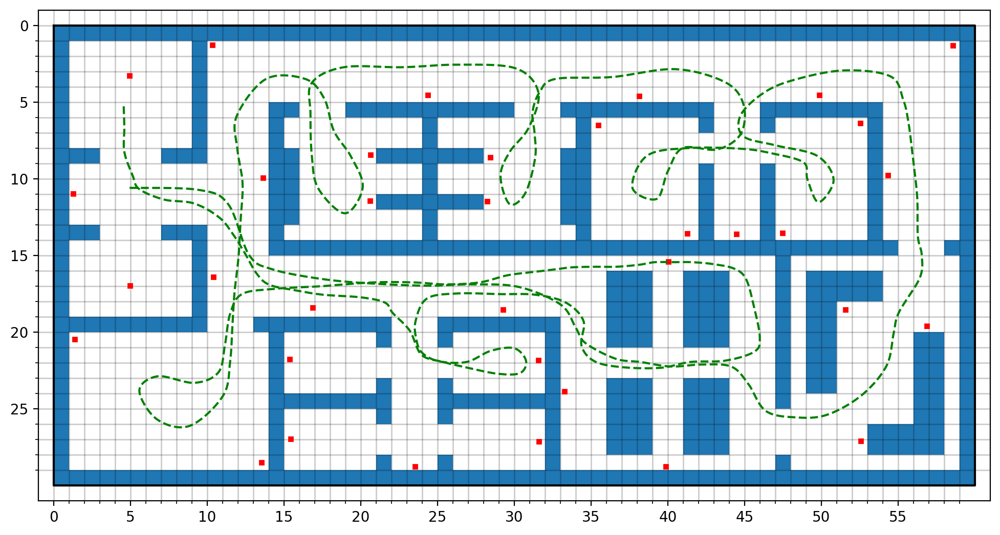

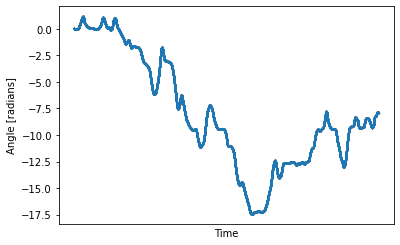

In [7]:

if plot:
    if rs.check_ipython():
        ws.plot(figname='Workspace', grid_size=1)

        route_x = [pose.x for pose in full_route]
        route_y = [pose.y for pose in full_route]

        plt.plot(route_x, route_y, '--', color='green')

        plt.figure('Angle')

        ax = plt.gca()
        ax.set_ylabel('Angle [radians]')
        ax.set_xlabel('Time')
        ax.set_xticks([])

        plt.plot([pose.theta for pose in full_route], '.', markersize=1)

        plt.show(block=False)


In [8]:
route = rs.reduce_list(full_route, 0.01)

#default_route = False

print(f'Reduced route from {len(full_route)} nodes to {len(route)} nodes.')


Reduced route from 35761 nodes to 358 nodes.


In [9]:
from tqdm import tqdm

print(f'Default landmarks - {default_landmarks} and default route - {default_route}: ', end='')

default_measurements = (default_landmarks and default_route)

if not default_measurements:
    print('Computing measurements.')
    landmarks = []
    for pose in tqdm(route):
        measurements = []
        for i, landmark in enumerate(ws.landmarks):
            origin = rs.Point(pose.x, pose.y)
            landmark = rs.Point(*landmark)
            line = rs.Line(origin, landmark)

            intersections = ws.get_intersections(line)
            intersections = [rs.Point(*i) for i in intersections]
            
            d = rs.dist_l2(origin, landmark)

            if not any([False] + [d > rs.dist_l2(origin, i) for i in intersections]):
                pt = landmark.relative(pose)
                measurements.append((i, pt))
        landmarks.append(measurements)
else:
    print('Using pre-computed measurements.')
    path = os.path.join(cwd, 'data/office_workspace_1_default_landmark_measurements.json')
    with open(path, 'r') as f:
        landmarks = json.load(f)
    
    landmarks = [[(pt[0], rs.Point(*pt[1:])) for pt in measurements] for measurements in landmarks]
    

Default landmarks - True and default route - True: Using pre-computed measurements.


In [10]:
path = os.path.join(cwd, 'data/office_workspace_1_default_landmark_measurements.json')
with open(path, 'w') as f:
    json.dump([[[i, pt.x, pt.y] for i, pt in measurements] for measurements in landmarks], f)


In [11]:
if not default_route:
    lidar_scans = [ws.lidar_scan(pose, fov=360, da=1.25) for pose in tqdm(route)]
    lidar_scans = [[pt.relative(pose) for pt in scan] for pose, scan in zip(route, lidar_scans)]
 
    path = os.path.join(cwd, 'data/office_workspace_1_default_lidar_scans.json')
    with open(path, 'w') as f:
        obj = [[[pt.x, pt.y] for pt in scan] for scan in lidar_scans]
        json.dump(obj, f)

else: 
    path = os.path.join(cwd, 'data/office_workspace_1_default_lidar_scans.json')
    with open(path, 'r') as f:
        lidar_scans = json.load(f)
        lidar_scans = [[rs.Point(*pt) for pt in scan] for scan in lidar_scans]
        

In [12]:
from robsim.utility import add_radial_noise_pose as noise

odometry_std_d = 0.1
odometry_std_a1 = 0.07
odometry_std_a2 = 0.07

print(f'Adding odometry noise with standard deviations:\ndistance - {odometry_std_d}\nangle 1 - {odometry_std_a1}\nangle 2 - {odometry_std_a2}')

relative_route = [b.relative(a) for a, b in zip(route[:-1], route[1:])]
noisy_relative_route = [noise(pose, std_d=odometry_std_d, std_a1=odometry_std_a1, std_a2=odometry_std_a2) for pose in relative_route]
noisy_route = [route[0]]
for pose in noisy_relative_route: noisy_route.append(pose.absolute(noisy_route[-1]))


Adding odometry noise with standard deviations:
distance - 0.1
angle 1 - 0.07
angle 2 - 0.07


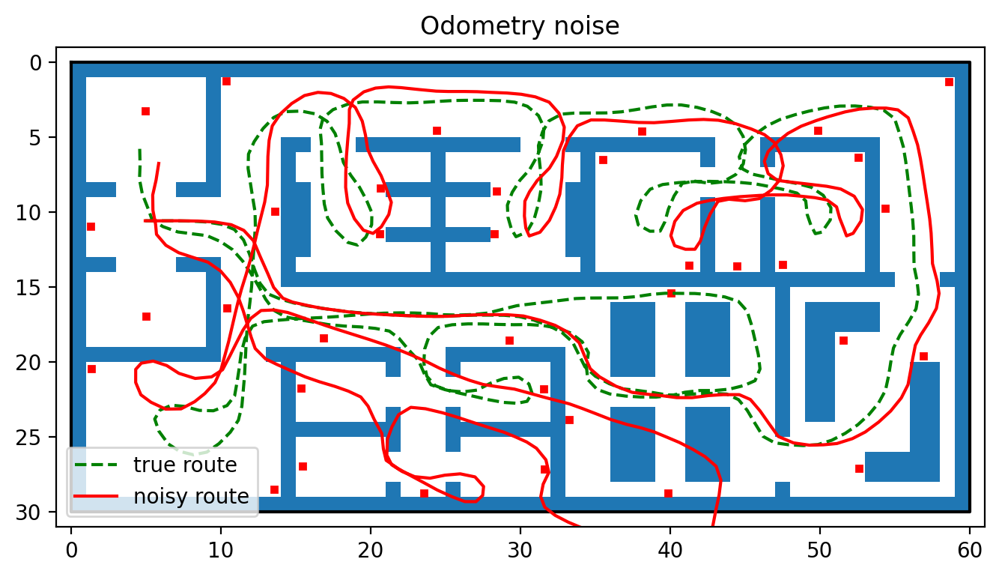

In [13]:
if plot:
    fig = ws.plot(figname='Workspace', figsize=(8, 8))
    plt.title('Odometry noise')
    plt.plot([p.x for p in route], [p.y for p in route], '--', color='green', label='true route')
    plt.plot([p.x for p in noisy_route], [p.y for p in noisy_route], '-', color='red', label='noisy route')
    plt.legend()
    plt.show()


In [14]:
from robsim.utility import add_radial_noise_point as noise
landmark_std_d = 0.01
landmark_std_a = 0.005

print(f'Adding landmark noise with standard deviations:\ndistance - {landmark_std_d}\nangle - {landmark_std_a}')

noisy_landmarks = [[[i, noise(point, std_d=landmark_std_d, std_a=landmark_std_a)] for i, point in measurements] for measurements in tqdm(landmarks)]


100%|██████████| 358/358 [00:00<00:00, 22436.47it/s]Adding landmark noise with standard deviations:
distance - 0.01
angle - 0.005



100%|██████████| 35/35 [00:00<00:00, 797.58it/s]Plotting points...



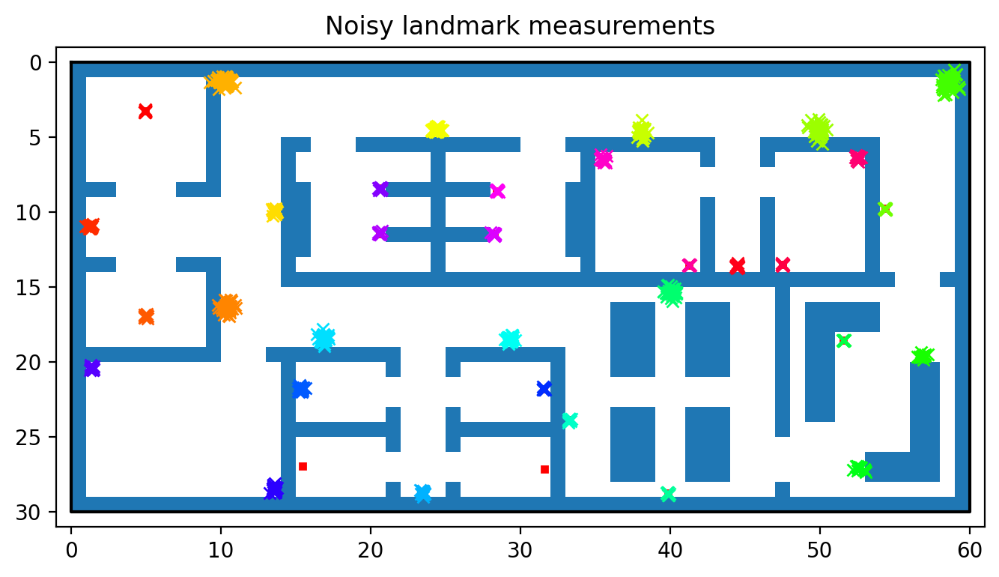

In [15]:
if plot:
    cmap = plt.cm.get_cmap('hsv', len(ws.landmarks))

    fig = ws.plot(figname='Workspace', figsize=(8, 8))
    plt.title('Noisy landmark measurements')

    print('Plotting points...')
    for i in tqdm(range(len(ws.landmarks))):
        pts = []
        for j, measurements in enumerate(noisy_landmarks):
            for k, point in measurements:
                if i == k:
                    pts.append(point.absolute(route[j]))

        plt.plot([pt.x for pt in pts], [pt.y for pt in pts], 'x', color=cmap(i))
    plt.show()


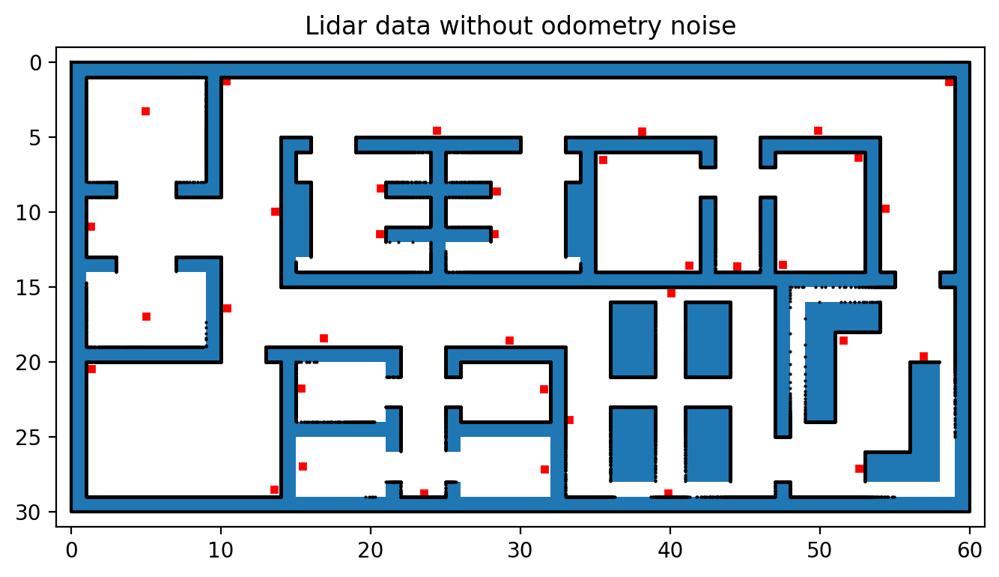

In [16]:
if plot:
    lidar_absolute = [[pt.absolute(pose) for pt in scan] for pose, scan in zip(route, lidar_scans)]

    ws.plot(figsize=(8, 8), dpi=200)
    plt.title('Lidar data without odometry noise')
    x = [pt.x for scan in lidar_absolute for pt in scan]
    y = [pt.y for scan in lidar_absolute for pt in scan]
    plt.plot(x, y, '.', color='black', markersize=1)
    plt.show()


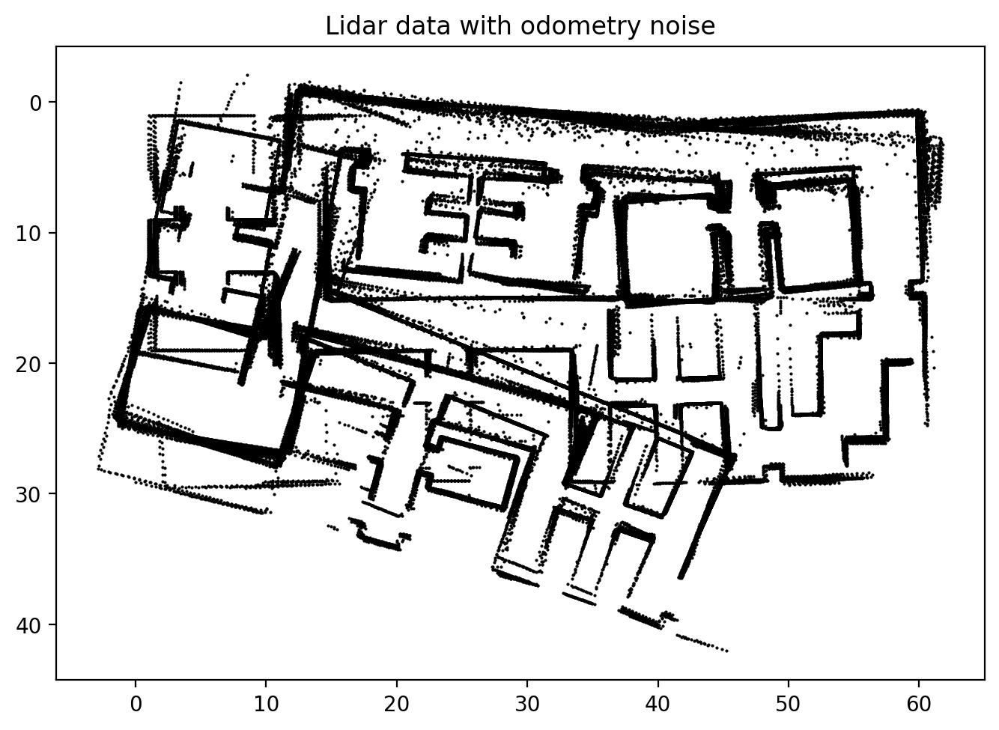

In [17]:
if plot:
    noisy_lidar_absolute = [[pt.absolute(pose) for pt in scan] for pose, scan in zip(noisy_route, lidar_scans)]

    plt.figure(figsize=(8, 8), dpi=200)
    plt.title('Lidar data with odometry noise')
    x = [pt.x for scan in noisy_lidar_absolute for pt in scan]
    y = [pt.y for scan in noisy_lidar_absolute for pt in scan]
    plt.plot(x, y, '.', color='black', markersize=1)
    ax = plt.gca()
    ax.invert_yaxis()
    ax.set_aspect(1)
    plt.plot()
    plt.show()

In [18]:
print(f'{len(route)}, {len(noisy_route)}, {len(relative_route)}, {len(noisy_relative_route)}')


358, 358, 357, 357


In [19]:
gps_points = {}

if n_gps != None:
    print(f'Adding gps points every {n_gps}th point.')
    print(f'Applying gps noise with std of: {std_gps}')
    for i, pose in enumerate(route):
        if i % n_gps == 0:
            gps_constraint = rs.add_normal_noise_point(rs.Point(pose.x, pose.y), std_gps)
            gps_points[i] = gps_constraint

else:
    print(f'Not using gps.')



Adding gps points every 10th point.
Applying gps noise with std of: 2


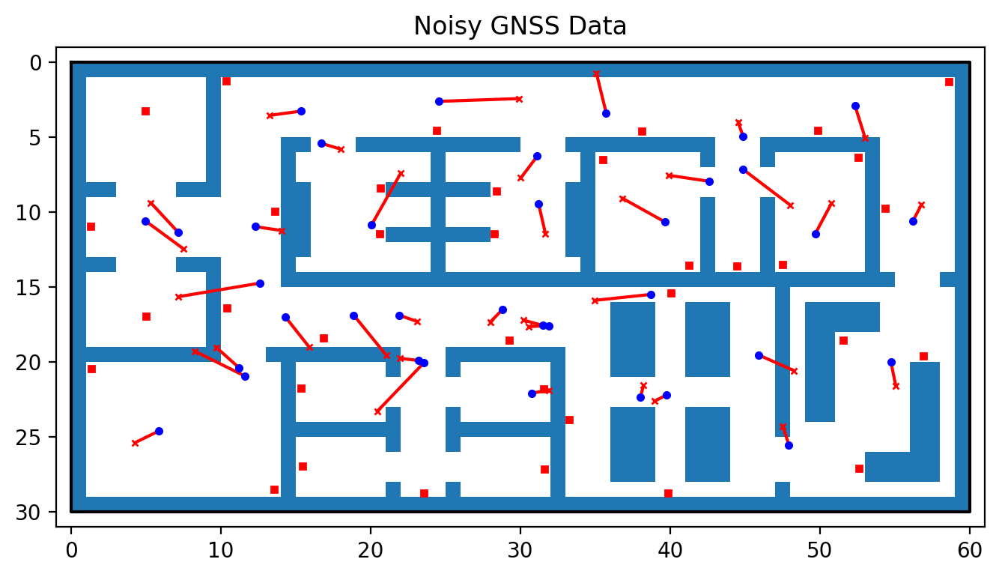

In [20]:
if n_gps != None and plot:
    ws.plot(figsize=(8, 8), dpi=200)
    plt.title('Noisy GNSS Data')

    for i, pt in zip(gps_points.keys(), gps_points.values()):
        plt.plot((route[i].x, pt.x), (route[i].y, pt.y), '-', color='red')

    plt.plot([route[i].x for i in gps_points], [route[i].y for i in gps_points], 'o', color='blue', markersize=3)
    plt.plot([pt.x for pt in gps_points.values()], [pt.y for pt in gps_points.values()], 'x', color='red', markersize=3)
    plt.show()


In [21]:
std_gis = 0.5

gis_points = []

if include_gis:
    print(f'Applying gis noise with std of: {std_gis}')

    for i, landmark in enumerate(ws.landmarks):
        point = rs.Point(*landmark)
        noisy_point = rs.add_normal_noise_point(point, std_gis)
        
        gis_points.append((i, noisy_point))
else:
    print(f'Not using gis.')


Applying gis noise with std of: 0.5


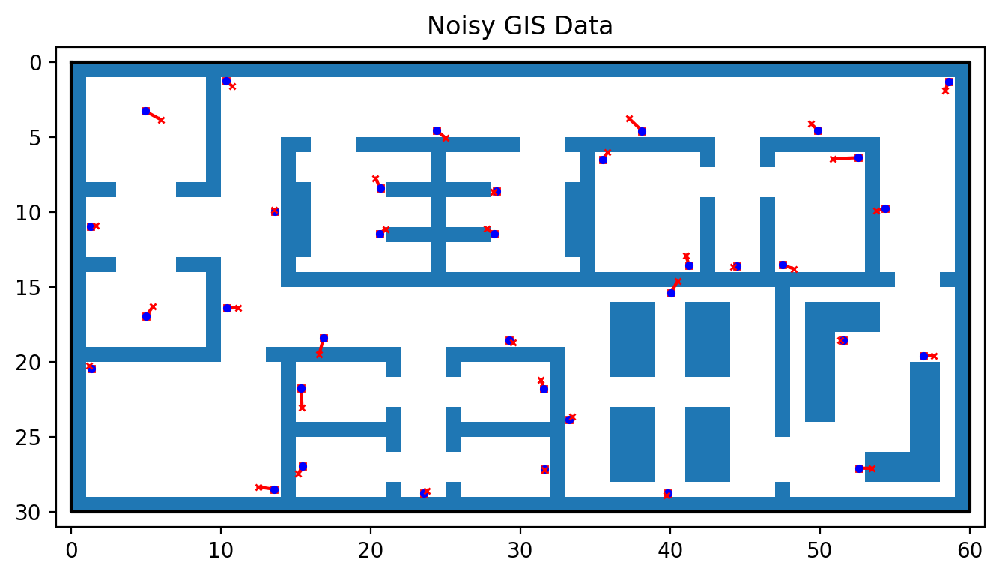

In [22]:
if include_gis and plot:
    ws.plot(figsize=(8, 8), dpi=200)
    plt.title('Noisy GIS Data')

    for origin, (i, pt) in zip(ws.landmarks, gis_points):
        plt.plot((origin[0], pt.x), (origin[1], pt.y), '-', color='red')

    plt.plot([pt[0] for pt in ws.landmarks], [pt[1] for pt in ws.landmarks], 'o', color='blue', markersize=3)
    plt.plot([pt.x for _, pt in gis_points], [pt.y for _, pt in gis_points], 'x', color='red', markersize=3)
    plt.show()


In [23]:
loss = 'soft_l1'
sparsity = True
tr_solver = 'lsmr'


use_tqdm = True

plot = 'animate'

n_slam_steps = len(noisy_relative_route)

to_print = [
    f'Doing slam with options: ({plot})',
    f'Loss function - {loss}',
    f'Using sparsity matrix - {sparsity}',
    f'Trust-region Solver - {tr_solver}',
    f'gtol - {gtol}',
    f'xtol - {xtol}',
    f'ftol - {ftol}'
]

print('\n'.join(to_print))

slam = rs.Slam(route[0], len(ws.landmarks), var_odometry_d=odometry_std_d, var_odometry_theta1=odometry_std_a1, var_odometry_theta2=odometry_std_a2, var_landmarks_d=landmark_std_d, var_landmarks_theta=landmark_std_a, var_gps=std_gps**2, var_gis=std_gis**2 / 5, landmark_estimates=gis_points)

for i in tqdm(range(n_slam_steps)):   
    odometry_constraint, landmark_constraints = noisy_relative_route[i], noisy_landmarks[i + 1]    

    gps_constraint = None
    if i in gps_points:
        gps_constraint = gps_points[i]

    slam.add_constraints(odometry_constraint, landmark_constraints, gps_constraint)
    slam.optimize(use_sparsity=sparsity, loss=loss, tr_solver=tr_solver, ftol=ftol, gtol=gtol, xtol=xtol)


  1%|          | 2/357 [00:00<00:18, 19.66it/s]Doing slam with options: (animate)
Loss function - soft_l1
Using sparsity matrix - True
Trust-region Solver - lsmr
gtol - 0.0001
xtol - 0.0001
ftol - 0.0001
100%|██████████| 357/357 [02:45<00:00,  2.16it/s]


route: 358
landmarks: 35
m = 1589, n = 1144
Sparsity matrix shape: (1660, 1144)


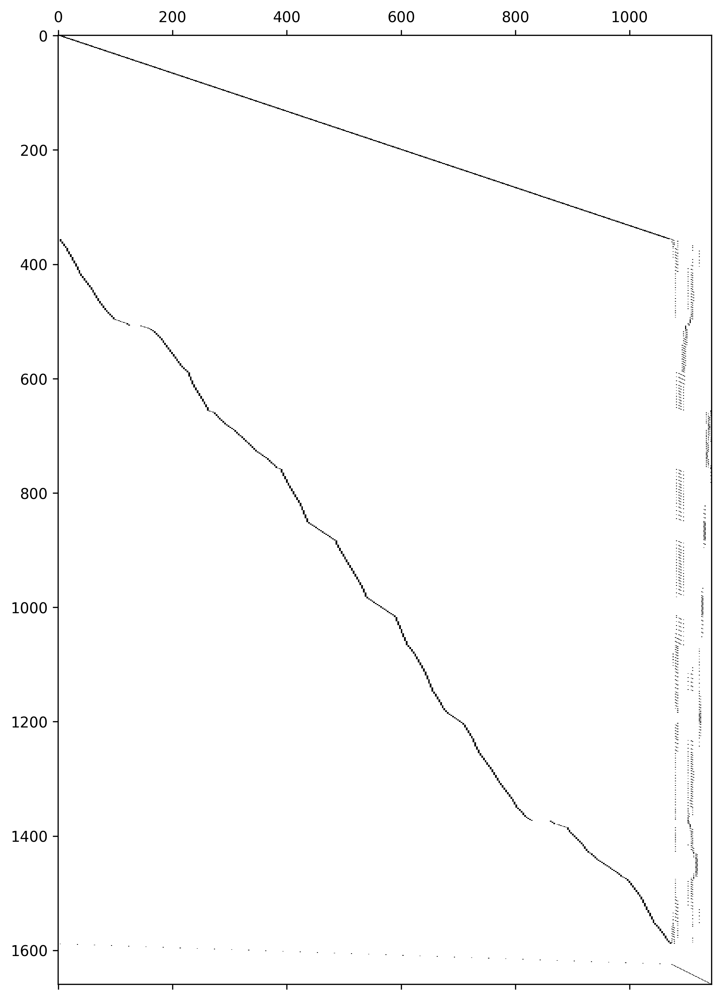

In [24]:

sparsity = slam.get_sparsity()

print(f'route: {len(slam.route)}')
print(f'landmarks: {len(slam.landmarks)}')

n = len(slam.route)*3+len(slam.landmarks)*2
m = len(slam.odometry_constraints) + sum(len(constraints) for constraints in slam.landmark_constraints)

print(f'm = {m}, n = {n}')
print(f'Sparsity matrix shape: {sparsity.shape}')

fig = plt.figure(figsize=(8,12), dpi=300)
plt.spy(sparsity)

plt.show(block=False)
fig.savefig(f'plots/{some_id_for_plots}_sparsity.pdf')


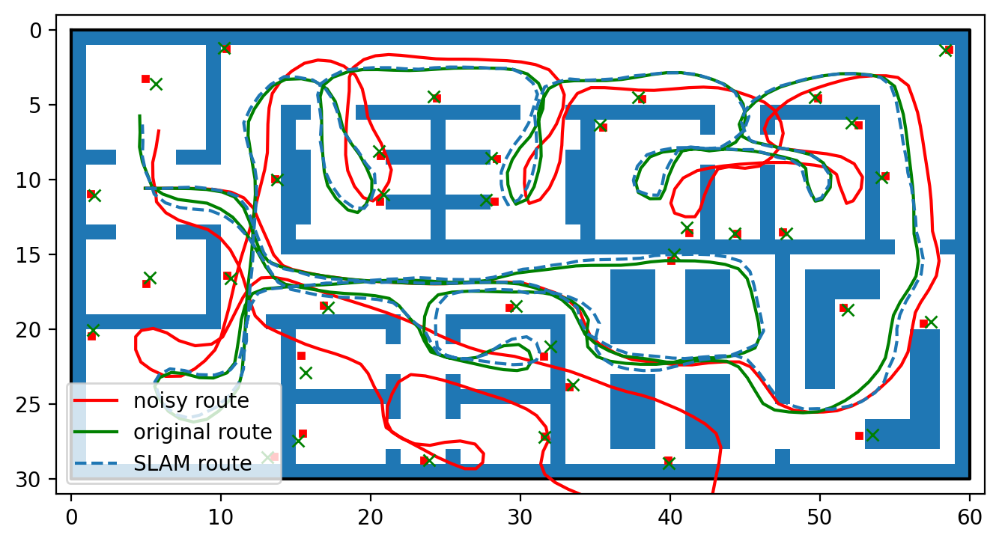

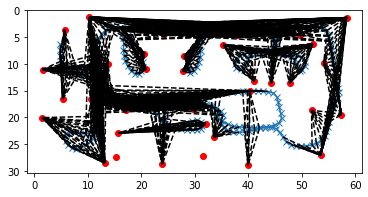

In [25]:
fig = ws.plot(figsize=(8, 8), dpi=200)

x = [pt.x for pt in noisy_route]
y = [pt.y for pt in noisy_route]
plt.plot(x, y, '-', color='red', label='noisy route')

x = [pt.x for pt in route]
y = [pt.y for pt in route]
plt.plot(x, y, '-', color='green', label='original route')

x = [pt.x for pt in slam.route]
y = [pt.y for pt in slam.route]
plt.plot(x, y, '--', label='SLAM route')

x = [pt.x for pt in slam.landmarks if pt != None]
y = [pt.y for pt in slam.landmarks if pt != None]
plt.plot(x, y, 'x', color='green')

plt.legend()

plt.show(block=False)
fig.savefig(f'plots/{some_id_for_plots}_SLAM_plot.pdf')

fig = slam.plot(plot_landmark_measurements=True)
ax = plt.gca()
ax.invert_yaxis()
plt.show(block=False)
fig.savefig(f'plots/{some_id_for_plots}_SLAM_graph.pdf')

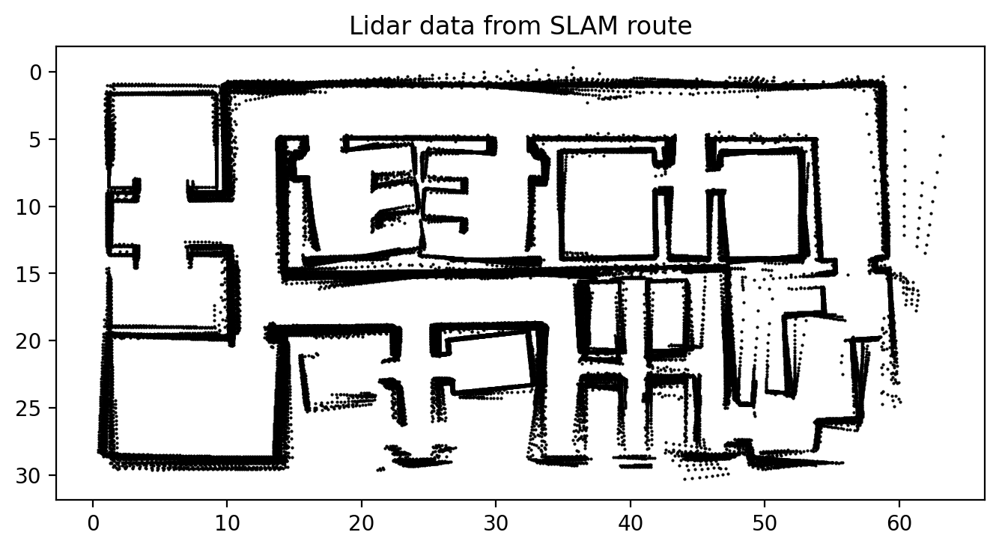

In [26]:
slam_lidar_absolute = [[pt.absolute(pose) for pt in scan] for pose, scan in zip(slam.route, lidar_scans)]

fig = plt.figure(figsize=(8, 8), dpi=200)
plt.title('Lidar data from SLAM route')
x = [pt.x for scan in slam_lidar_absolute for pt in scan]
y = [pt.y for scan in slam_lidar_absolute for pt in scan]
plt.plot(x, y, '.', color='black', markersize=1)
ax = plt.gca()
ax.invert_yaxis()
ax.set_aspect(1)
plt.plot()

plt.show(block=False)
fig.savefig(f'plots/{some_id_for_plots}_LIDAR_SLAM_PLOT.pdf')

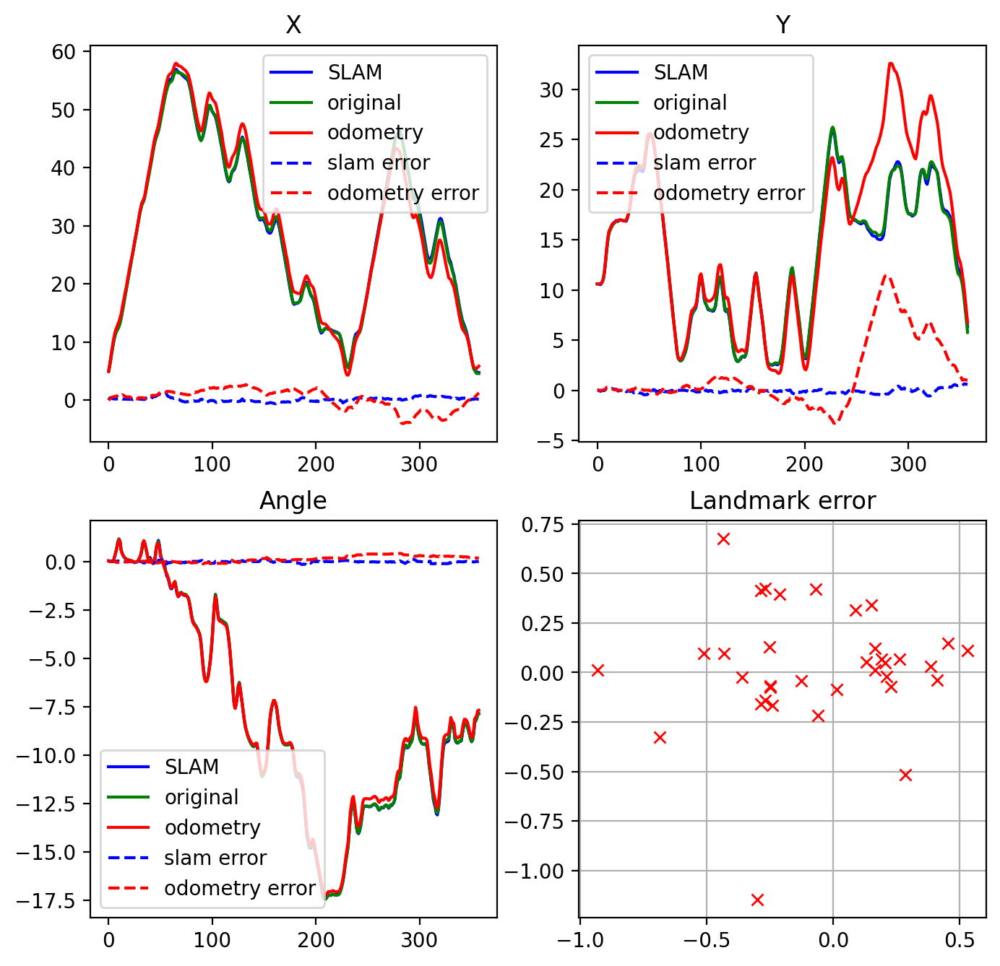

In [27]:
fig, axs = plt.subplots(2, 2, figsize=(8,8), dpi=200)

axs[0,0].set_title('X')
axs[0,0].plot([pose.x for pose in slam.route], '-', color='blue', label='SLAM')
axs[0,0].plot([pose.x for pose in route], '-', color='green', label='original')
axs[0,0].plot([pose.x for pose in noisy_route], '-', color='red', label='odometry')
axs[0,0].plot([b.x - a.x for a, b in zip(route, slam.route)], '--', color='blue', label='slam error')
axs[0,0].plot([b.x - a.x for a, b in zip(route, noisy_route)], '--', color='red', label='odometry error')
axs[0,0].legend()

axs[0,1].set_title('Y')
axs[0,1].plot([pose.y for pose in slam.route], '-', color='blue', label='SLAM')
axs[0,1].plot([pose.y for pose in route], '-', color='green', label='original')
axs[0,1].plot([pose.y for pose in noisy_route], '-', color='red', label='odometry')
axs[0,1].plot([b.y - a.y for a, b in zip(route, slam.route)], '--', color='blue', label='slam error')
axs[0,1].plot([b.y - a.y for a, b in zip(route, noisy_route)], '--', color='red', label='odometry error')
axs[0,1].legend()

axs[1,0].set_title('Angle')
axs[1,0].plot([pose.theta for pose in slam.route], '-', color='blue', label='SLAM')
axs[1,0].plot([pose.theta for pose in route], '-', color='green', label='original')
axs[1,0].plot([pose.theta for pose in noisy_route], '-', color='red', label='odometry')
axs[1,0].plot([b.theta - a.theta for a, b in zip(route, slam.route)], '--', color='blue', label='slam error')
axs[1,0].plot([b.theta - a.theta for a, b in zip(route, noisy_route)], '--', color='red', label='odometry error')
axs[1,0].legend()

landmark_locations = [rs.Point(*pt) for pt in ws.landmarks]

error_landmarks = [b - a for a, b, i in zip(slam.landmarks, landmark_locations, slam.landmark_initialized) if i]

axs[1,1].set_title('Landmark error')
axs[1,1].plot([pt.x for pt in error_landmarks], [pt.y for pt in error_landmarks], 'x', color='red')
axs[1,1].grid(True)

plt.show(block=False)
fig.savefig(f'plots/{some_id_for_plots}_slam_error_plots.pdf')


In [28]:

print('Route errors:')

noisy_diff = [a - b for a, b in zip(route, noisy_route)]
noisy_metric_d = np.average([abs(rs.dist_l2(rs.Point(0, 0), p)) for p in noisy_diff])
noisy_metric_a = np.average([abs(p.theta) for p in noisy_diff])
#noisy_metric_combined = 2*((noisy_metric_d*noisy_metric_a)/(noisy_metric_d+noisy_metric_a))

print(f'Noisy route: \nAverage error distance: {noisy_metric_d} \nAverage error angle: {noisy_metric_a}')

slam_diff = [a - b for a, b in zip(route, slam.route)]
slam_metric_d = np.average([abs(rs.dist_l2(rs.Point(0, 0), p)) for p in slam_diff])
slam_metric_a = np.average([abs(p.theta) for p in slam_diff])
#slam_metric_combined = 2*((slam_metric_d*slam_metric_a)/(slam_metric_d+slam_metric_a))

print(f'SLAM route: \nAverage error distance: {slam_metric_d} \nAverage error angle: {slam_metric_a}')


Route errors:
Noisy route: 
Average error distance: 3.0452778648740524 
Average error angle: 0.1574054851265972
SLAM route: 
Average error distance: 0.3721418464457935 
Average error angle: 0.034007406407442035


In [29]:

print('Landmark errors:')

average_noisy_landmarks = [[0, [0, 0]] for _ in ws.landmarks]

for pose, row in zip(route, noisy_landmarks):
    for i, point in row:
        point = point.absolute(pose)

        average_noisy_landmarks[i][0] += 1
        average_noisy_landmarks[i][1][0] += point.x
        average_noisy_landmarks[i][1][1] += point.y

def selection(n, x, y):
    if n > 0:
        return rs.Point(x/n, y/n)
    return rs.Point(-1, -1)

average_noisy_landmarks = [selection(n, x, y) for n, (x, y) in average_noisy_landmarks] 

noisy_landmark_diff = [rs.Point(*a) - b for a, b in zip(ws.landmarks, average_noisy_landmarks)]
noisy_landmark_metric = np.average([abs(rs.dist_l2(rs.Point(0, 0), p)) for p in noisy_landmark_diff])

print(f'Noisy landmarks: {noisy_landmark_metric}')

slam_landmark_diff = [rs.Point(*a) - b for a, b in zip(ws.landmarks, slam.landmarks)]
slam_landmark_metric = np.average([abs(rs.dist_l2(rs.Point(0, 0), p)) for p in slam_landmark_diff])

print(f'SLAM landmarks: {slam_landmark_metric}')


Landmark errors:
Noisy landmarks: 2.179827909466648
SLAM landmarks: 0.3948276053645474


In [30]:

with open(f'plots/{some_id_for_plots}_results.json', 'w') as f:
    json.dump({'ftol': ftol, 'gis': include_gis, 'gps': n_gps, 'osd': slam_metric_d, 'osa': slam_metric_a, 'ls': slam_landmark_metric}, f)

rs.save_to_json(rs.from_points(slam.landmarks), f'data/{some_id_for_plots}_landmarks.json')
rs.save_to_json(rs.from_pose(slam.route), f'data/{some_id_for_plots}_route.json')